'''
Lab 9 - Sentiment Scoring (Part 2)

In this script, we perform sentiment scoring using a rule-based approach.

We have a pre-defined list of dictionaries (inside dict2/ directory):
1) positive words
2) negative words
3) incrementers
4) decrementers
5) inverters

Unlike in Part 1, sentiment words (positive/negative) are on a scale of -3 to 3.
For example, some positive words are MORE positive than others. More positive words will have a more positive score.
Likewise, some negative words are MORE negative than others. More negative words will have a more negative score.

We will:

- Perform Part-Of-Speech (POS) tagging
- Extract out Verbs, Nouns and Adjectives
- Perform dictionary-based sentiment scoring
--> If a term is identified to be positive, assign a score of +1/+2/+3 (least positive to most positive)
--> If a term is identified to be negative, assign a score of -1/-2/-3 (least negative to most negative)
'''

In [1]:
# Import packages
import nltk
from pprint import pprint
import yaml
import sys
import os
import re
from nltk.tokenize import sent_tokenize, word_tokenize, RegexpTokenizer
from nltk.corpus import stopwords
from nltk.stem import PorterStemmer
from wordcloud import WordCloud
import matplotlib.pyplot as plt
import json

dict_tagged_sentences = ''
# Below indicates the relative path to
# positive/negative/inverter/incrementer/decrementer files
DICTIONARY_DIR_PREFIX = 'dicts2/'

In [2]:
class Splitter(object):
    def __init__(self):
        self.nltk_splitter = nltk.data.load('tokenizers/punkt/english.pickle')
        self.nltk_tokenizer = nltk.tokenize.TreebankWordTokenizer()

    def split(self, text):
        """
        input format: a paragraph of text
        output format: a list of lists of words.
            e.g.: [['this', 'is', 'a', 'sentence'], ['this', 'is', 'another', 'one']]
        """
        sentences = self.nltk_splitter.tokenize(text)
        tokenized_sentences = [self.nltk_tokenizer.tokenize(sent) for sent in sentences]
        return tokenized_sentences


class POSTagger(object):
    def __init__(self):
        pass

    def pos_tag(self, sentences):
        """
        input format: list of lists of words
            e.g.: [['this', 'is', 'a', 'sentence'], ['this', 'is', 'another', 'one']]
        output format: list of lists of tagged tokens. Each tagged tokens has a
        form, a lemma, and a list of tags
            e.g: [[('this', 'this', ['DT']), ('is', 'be', ['VB']), ('a', 'a', ['DT']), ('sentence', 'sentence', ['NN'])],
                    [('this', 'this', ['DT']), ('is', 'be', ['VB']), ('another', 'another', ['DT']), ('one', 'one', ['CARD'])]]
        """

        pos = [nltk.pos_tag(sentence) for sentence in sentences]
        #adapt format
        pos = [[(word, word, [postag]) for (word, postag) in sentence] for sentence in pos]
        return pos

class DictionaryTagger(object):
    def __init__(self, dictionary_paths):
        """

        :rtype : object
        """
        files = [open(path, 'r') for path in dictionary_paths]
        dictionaries = [yaml.load(dict_file) for dict_file in files]
        map(lambda x: x.close(), files)
        self.dictionary = {}
        self.max_key_size = 0
        for curr_dict in dictionaries:
            for key in curr_dict:
                if key in self.dictionary:
                    self.dictionary[key].extend(curr_dict[key])
                else:
                    self.dictionary[key] = curr_dict[key]
                    self.max_key_size = max(self.max_key_size, len(key))

    def tag(self, postagged_sentences):
        return [self.tag_sentence(sentence) for sentence in postagged_sentences]

    def tag_sentence(self, sentence, tag_with_lemmas=False):
        """
        the result is only one tagging of all the possible ones.
        The resulting tagging is determined by these two priority rules:
            - longest matches have higher priority
            - search is made from left to right
        """
        tag_sentence = []
        N = len(sentence)
        if self.max_key_size == 0:
            self.max_key_size = N
        i = 0
        while (i < N):
            j = min(i + self.max_key_size, N) #avoid overflow
            tagged = False
            while (j > i):
                expression_form = ' '.join([word[0] for word in sentence[i:j]]).lower()
                expression_lemma = ' '.join([word[1] for word in sentence[i:j]]).lower()
                if tag_with_lemmas:
                    literal = expression_lemma
                else:
                    literal = expression_form
                if literal in self.dictionary:
                    #self.logger.debug("found: %s" % literal)
                    is_single_token = j - i == 1
                    original_position = i
                    i = j
                    taggings = [tag for tag in self.dictionary[literal]]
                    tagged_expression = (expression_form, expression_lemma, taggings)
                    if is_single_token: #if the tagged literal is a single token, conserve its previous taggings:
                        original_token_tagging = sentence[original_position][2]
                        tagged_expression[2].extend(original_token_tagging)
                    tag_sentence.append(tagged_expression)
                    tagged = True
                else:
                    j = j - 1
            if not tagged:
                tag_sentence.append(sentence[i])
                i += 1
        return tag_sentence

def value_of(sentiment):
    if sentiment == 'positive1': return 1
    if sentiment == 'positive2': return 2
    if sentiment == 'positive3': return 3
    if sentiment == 'negative1': return -1
    if sentiment == 'negative2': return -2
    if sentiment == 'negative3': return -3
    return 0

def sentiment_score(review):
    return sum ([value_of(tag) for sentence in dict_tagged_sentences for token in sentence for tag in token[2]])

def sentence_score(sentence_tokens, previous_token, acum_score):
    if not sentence_tokens:
        return acum_score
    else:
        current_token = sentence_tokens[0]
        tags = current_token[2]
        token_score = sum([value_of(tag) for tag in tags])
        if previous_token is not None:
            previous_tags = previous_token[2]
            if 'inc' in previous_tags:
                token_score *= 2.0
            elif 'dec' in previous_tags:
                token_score /= 2.0
            elif 'inv' in previous_tags:
                token_score *= -1.0
        return sentence_score(sentence_tokens[1:], current_token, acum_score + token_score)

def sentiment_score(sentences):
    return sum([sentence_score(sentence, None, 0.0) for sentence in sentences])

with_score = []

def run_analysis(text):
    splitter = Splitter() # This boy will split a long single string into sentences.
    postagger = POSTagger() # This boy is the Part-Of-Speech tagger.

    # If text contains multiple sentences, this line splits it into individual sentences.
    splitted_sentences = splitter.split(text)
#     print (splitted_sentences)
    #exit(1)

#     print ("########## This performs Part-Of-Speech tagging. ##########")
    # This performs Part-Of-Speech tagging.
    pos_tagged_sentences = postagger.pos_tag(splitted_sentences)
    #pprint (pos_tagged_sentences)
    #exit(1)

#     print ("########## This line loads Positive word and Negative word corpus. ##########")
    # This line loads Positive word and Negative word dictionaries.
    dicttagger = DictionaryTagger([ DICTIONARY_DIR_PREFIX + 'positive.yml', DICTIONARY_DIR_PREFIX + 'negative.yml'])
    dict_tagged_sentences = dicttagger.tag(pos_tagged_sentences)
    #pprint(dict_tagged_sentences)
    #exit(1)

#     print ("########## [Baseline Analysis] Using only Positive/Negative corpus. ##########")
    score = sentiment_score(dict_tagged_sentences)
#     print ("Score: %d" % score)
    #exit(1)

#     print ("########## This line loads Positve/Negative corpus + incrementer/decrementer corpus. ##########")
    dicttagger = DictionaryTagger([ DICTIONARY_DIR_PREFIX + 'positive.yml', DICTIONARY_DIR_PREFIX + 'negative.yml', DICTIONARY_DIR_PREFIX + 'inc.yml', DICTIONARY_DIR_PREFIX + 'dec.yml'])
    dict_tagged_sentences = dicttagger.tag(pos_tagged_sentences)
    #pprint(dict_tagged_sentences)
    score = sentiment_score(dict_tagged_sentences)
#     print ("Score: %d" % score)
    #exit(1)

#     print ("########## This line loads Positve/Negative corpus + incrementer/decrementer/inverter corpus. ##########")
    dicttagger = DictionaryTagger([ DICTIONARY_DIR_PREFIX + 'positive.yml', DICTIONARY_DIR_PREFIX + 'negative.yml', DICTIONARY_DIR_PREFIX + 'inc.yml', DICTIONARY_DIR_PREFIX + 'dec.yml', DICTIONARY_DIR_PREFIX + 'inv.yml'])
    dict_tagged_sentences = dicttagger.tag(pos_tagged_sentences)
    #pprint(dict_tagged_sentences)
    score = sentiment_score(dict_tagged_sentences)
#     print ("Score: %d" % score)
    #exit(1)
    
    with_score.append([text, score])
        

In [11]:

#     review_comment_text = "This restaurant really sucks. The service was terrible. Food was horrible."
sentences = []

json1_file = open('../Lab2/data.json')
json1_str = json1_file.read()
text = json.loads(json1_str)

stop_words = stopwords.words('english')

for i, t in enumerate(text):
    if sent_tokenize(text[i]['msg']) not in stop_words:
             sentences.append(sent_tokenize(text[i]['msg']))
   

# Run sentiment scoring
# with open('Yelp_Food_Input.txt') as f:
#     for review in f:
# #             reviews.append(review)
#         quoted = re.compile('"[^"]*"')
#         for text in quoted.findall(review):
#             reviews.append(text)

print(sentences)

#     del reviews[0]       
#     print(reviews)
    

#     run_analysis(review)
    
    ###################### Challenge ######################
    # Modify this script to read from 'Yelp_Food_Input.txt'
    #   Each row is a unique "review" (textual)
    # Open the TXT file and see how to extract the review content (which column contains the content?)
    # Attempt to score each review
    # Summarize the sentiment scores across ALL reviews using apprpriate charts, e.g. bar chart, box plot, etc.

[["AY2020/21 THREAD:https://forums.hardwarezone.com.sg/d...e-6192001.html Due to the recent influx in posts for next year's application... for organisation's sake, do ask your questions here!", '(Create an account if necessary)Strictly for NUS, NTU and SMU AY2019/20 only.', 'For other unis please look up on their respective pages.Links will be updated from time to time.For chance rating: provide your (JC) grade profile & rank point - consider MT grade, rebase and take the higher of the two (original rank point or rebased rank point) or (Poly) poly course + 5th/6th sem CGPA + O Level L1R4, ranking of choices as well as citizenship status (Singaporean/ SPR/ International Student).15% of spaces for each university are reserved for DA.', 'NUS and NTU still counts 20% O Level results for this round of admissions (the policy will be scrapped from 2020).', 'For SMU, admission is based on 100% Poly GPA.', 'All O Level subject requirements still apply.', 'For NUS, first choice bonus admission p

In [10]:
print(sentences[1])

['NOTE FROM OP In view of the potential high rate of incidents of this thread in the Degree subforum (and the large amount of posters and lurkers reading this thread), do note that additional ground rules are imposed on this thread so as to maintain general order and minimise disputes.', 'This thread will be moderated very closely by the moderator and the OP, from time to time.', 'Any breakage of the general forum terms of service, subforum rules and/or additional thread ground rules WILL result in a warning or an infraction.', 'THREAD GROUND RULES:STRICTLY NO OUT-OF-TOPIC DISCUSSIONS (discussions limited to admission and matriculation concerns only)NO SENSELESS AND UNCONSTRUCTIVE ARGUMENTS OF ANY KINDNO ABUSIVE/ INSENSITIVE/ SARCASTIC/ CONDESCENDING LANGUAGENO XENOPHOBIC COMMENTS TOWARDS FOREIGNERS IN THIS THREAD This thread strives to welcome everyone, regardless of nationality and background; the least one can do is to be nice and harmonious to everyone, and exercise sensitivity on 

In [11]:
reviews_sentences = []
for r in sentences:
    for s in r:
        reviews_sentences.append(sent_tokenize(s))
print (reviews_sentences)

[["AY2020/21 THREAD:https://forums.hardwarezone.com.sg/d...e-6192001.html Due to the recent influx in posts for next year's application... for organisation's sake, do ask your questions here!"], ['(Create an account if necessary)Strictly for NUS, NTU and SMU AY2019/20 only.'], ['For other unis please look up on their respective pages.Links will be updated from time to time.For chance rating: provide your (JC) grade profile & rank point - consider MT grade, rebase and take the higher of the two (original rank point or rebased rank point) or (Poly) poly course + 5th/6th sem CGPA + O Level L1R4, ranking of choices as well as citizenship status (Singaporean/ SPR/ International Student).15% of spaces for each university are reserved for DA.'], ['NUS and NTU still counts 20% O Level results for this round of admissions (the policy will be scrapped from 2020).'], ['For SMU, admission is based on 100% Poly GPA.'], ['All O Level subject requirements still apply.'], ['For NUS, first choice bonus

In [12]:
print(reviews_sentences[0][0])

"*MEN looking to take your gf or soon to be gf or wife on a NICE CHEAP DATE?


In [12]:
if __name__ == "__main__":

    print ("###############################")
    
    for r in sentences:
        for s in r:
            run_analysis(s)

###############################


/home/ec2-user/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:43: YAMLLoadWarning: calling yaml.load() without Loader=... is deprecated, as the default Loader is unsafe. Please read https://msg.pyyaml.org/load for full details.


In [13]:
import pandas as pd

result = pd.DataFrame(with_score, columns=["review", "sentiment rating"])

In [14]:
result.to_csv("export_hardwarezone_comments_full.csv")

In [6]:
overview_rating = dict(result["sentiment rating"].value_counts())
overview_rating

{0.0: 48684,
 2.0: 836,
 -2.0: 176,
 1.0: 135,
 4.0: 58,
 -3.0: 38,
 3.0: 31,
 -1.0: 23,
 -4.0: 17,
 6.0: 8,
 -6.0: 6,
 5.0: 3,
 -9.0: 3,
 -5.0: 2,
 -8.0: 1,
 8.0: 1}

In [15]:
print("There are a total " + str(result["review"].count()) + " number of sentences.")
print()
key = sorted(overview_rating.keys())
for i in key:
    print(overview_rating[i], " of reviews scored a score", int(i))

There are a total 238935 number of sentences.

3  of reviews scored a score -9
1  of reviews scored a score -8
6  of reviews scored a score -6
2  of reviews scored a score -5
17  of reviews scored a score -4
38  of reviews scored a score -3
176  of reviews scored a score -2
23  of reviews scored a score -1
48684  of reviews scored a score 0
135  of reviews scored a score 1
836  of reviews scored a score 2
31  of reviews scored a score 3
58  of reviews scored a score 4
3  of reviews scored a score 5
8  of reviews scored a score 6
1  of reviews scored a score 8


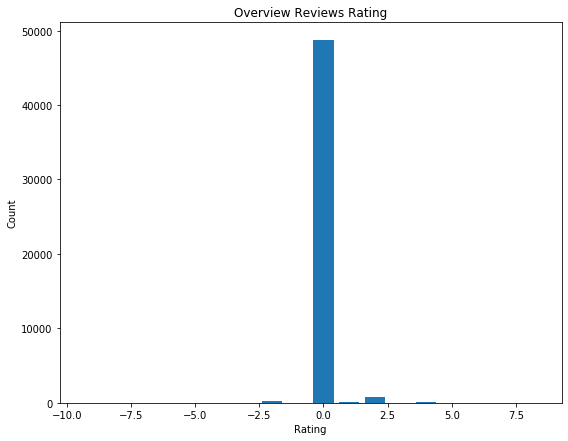

In [16]:
rating, count = [], []

fig = plt.figure(figsize=(9, 7))
for i in overview_rating:
    rating.append(int(i))
    count.append(overview_rating[i])

# ax = fig.add_axes([0,1,1,1])
# ax.bar(rating,count)
# plt.show()

plt.bar(rating, count)
plt.xlabel('Rating', fontsize=10)
plt.ylabel('Count', fontsize=10)
plt.title('Overview Reviews Rating')
plt.show()

In [18]:
result

,review,sentiment rating
0,AY2020/21 THREAD:https://forums.hardwarezone.c...,0.0
1,(Create an account if necessary)Strictly for N...,0.0
2,For other unis please look up on their respect...,0.0
3,NUS and NTU still counts 20% O Level results f...,0.0
4,"For SMU, admission is based on 100% Poly GPA.",0.0
5,All O Level subject requirements still apply.,0.0
6,"For NUS, first choice bonus admission points w...",0.0
7,[Poly to NUS SOC] Also note that if you are in...,0.0
8,NOTE FROM OP In view of the potential high rat...,0.0
9,This thread will be moderated very closely by ...,0.0
